In [1]:
import torch
import numpy as np
import plotly.graph_objects as go
import plotly.figure_factory as ff
import sys
import os
import pandas as pd
sys.path.append('../')
from common import make_env, perform_action, const_disturb_five, const_jitter_force, get_frame_skip_and_timestep
sys.path.append('../../')
import TD3


In [30]:
lr = np.load('../reflex/results/TD3_reflex_InvertedPendulum-v2_0_0.02_5.0_0.16_1.0_0.02_0.15_0.1.npy')

In [31]:
max_r = 0
for index, i in enumerate(lr):
    if i > max_r:
        max_r = i
    else:
        lr[index] = max_r

In [32]:
lr2 = np.load('../results/TD3_InvertedPendulum-v2_0_0.02_5.0_0.16_1.0_True_256.npy')

In [33]:
max_r = 0
for index, i in enumerate(lr2):
    if i > max_r:
        max_r = i
    else:
        lr2[index] = max_r

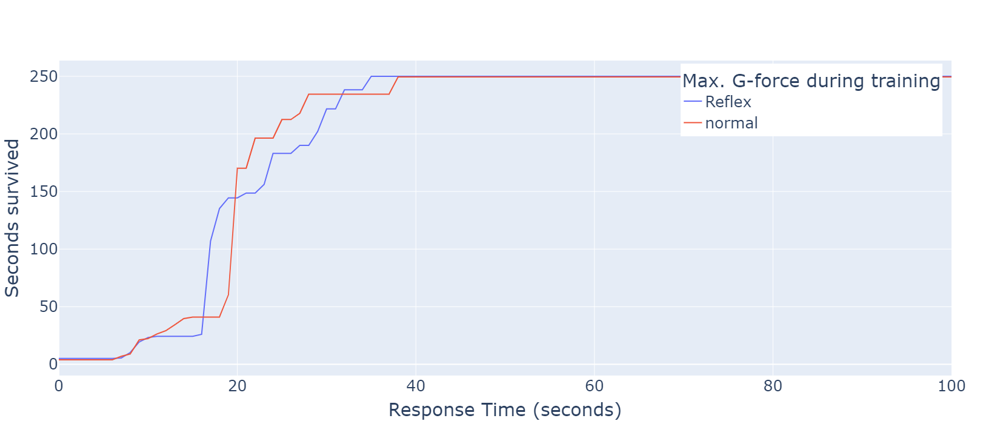

In [34]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=list(range(len(lr))), y=lr, mode='lines', name='Reflex'))
fig.add_trace(go.Scatter(x=list(range(len(lr2))), y=lr2, mode='lines', name='normal'))

fig.update_layout(
#     title='Average evaluation seconds for response times vs max. pertubation during training',
    xaxis_title="Response Time (seconds)",
    yaxis_title="Seconds survived",
    xaxis_side='bottom',
    legend_title="Max. G-force during training",
    font=dict(size=25),
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    ),
    height=700,
    width=1600
)
fig.show()

In [16]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
def eval_policy_increasing_force(policy, policy2, env_name, eval_episodes=10, time_change_factor=1,
                                 env_timestep=0.02, frame_skip=1, jit_frames=0, response_rate=0.04, delayed_env=False,
                                 reflex_frames=None):
    df = pd.DataFrame(columns=['angle', 'value reflex', 'value'])
    
    eval_env = make_env(env_name, 100, time_change_factor, env_timestep, frame_skip, delayed_env)
    if delayed_env:
        eval_env.env.env._max_episode_steps = 100000
    else:
        eval_env.env._max_episode_steps = 100000
    avg_reward = 0.
    avg_angle = 0.
    actions = 0


    t = 0
    forces = []
    force_times = []
    for _ in range(eval_episodes):
        eval_env.model.opt.gravity[0] = 0
        counter = 0
        disturb = 5
        force = 0.25 * 9.81
        prev_action = None
        jerk = 0
        jittered_frames = 0
        jittering = False
        jitter_force = 0
        reflex = False
        state, done = eval_env.reset(), False

        while not done:
            if not reflex_frames:
                _, action2 = policy.select_action(state)
                value = policy.critic.Q1(torch.FloatTensor(state.reshape(1, -1)).to(device),  torch.FloatTensor([action2]).to(device))
                
                action = policy2.select_action(state)
                value2 = policy2.critic.Q1(torch.FloatTensor(state.reshape(1, -1)).to(device), torch.FloatTensor([action]).to(device))
            else:
                reflex, action = policy.select_action(state)
                value = policy.critic.Q1(torch.FloatTensor(state.reshape(1, -1)).to(device),  torch.FloatTensor([action]).to(device))
                
                action2 = policy2.select_action(state)
                value2 = policy2.critic.Q1(torch.FloatTensor(state.reshape(1, -1)).to(device), torch.FloatTensor([action2]).to(device))

            df.loc[len(df.index)] = [state[1], value.detach().cpu().numpy()[0][0], value2.detach().cpu().numpy()[0][0]]
            
            if reflex:
                actions += 2
            else:
                actions += 1
            # Perform action
            jittering, disturb, counter, jittered_frames, jitter_force, force, next_state, reward, done = perform_action(
                jittering, disturb, counter, response_rate, eval_env, reflex, action, reflex_frames, frame_skip,
                const_jitter_force, force, env_timestep, jit_frames, jittered_frames, const_disturb_five, jitter_force, 1, delayed_env)

            avg_reward += reward
            avg_angle += abs(next_state[1])
            counter = round(counter, 3)
            state = next_state
            if counter == disturb:
                jitter_force, force = const_jitter_force(force)
                eval_env.model.opt.gravity[0] = jitter_force
                jittering = True
                jittered_frames = 0

            t += 1
            if prev_action:
                jerk += abs(action[0] - prev_action)
            prev_action = action[0]
                
    avg_reward /= eval_episodes
    avg_angle /= eval_episodes
    jerk /= t
    actions /= eval_episodes
    return avg_reward, avg_angle, jerk, actions, df

In [47]:
response_times = [0.16]
reflex_thresholds = [0.15, 0.17, 0.19]
reflex_response_rates = [0.02, 0.04, 0.08, 0.01]
reflex_force_scales = [1.0, 0.5, 1.5, -0.5, 2.0, .1]
g_forces = [5]
default_timestep = 0.02
default_frame_skip = 2
jit_duration = 0.02
env_name = 'InvertedPendulum-v2'
delayed_env = True

response_rate = 0.08
reflex_response_rate = 0.04
reflex_threshold = 0.15
reflex_force_scale = 0.5
g_force = 5.0
seed = 0
states = []
force = g_force * 9.81
arguments = ['TD3', 'reflex', env_name, seed, jit_duration, float(g_force), response_rate, 1.0, reflex_response_rate, reflex_threshold, reflex_force_scale, 'best']
arguments2 = ['TD3', env_name, seed, jit_duration, float(g_force), response_rate, 1.0, delayed_env, 256, 'best']

file_name = '_'.join([str(x) for x in arguments])
file_name2 = '_'.join([str(x) for x in arguments2])

frame_skip, timestep, jit_frames = get_frame_skip_and_timestep(jit_duration, response_rate, reflex_response_rate)
time_change_factor = (default_timestep * default_frame_skip) / (timestep * frame_skip)
eval_env = make_env(env_name, seed, time_change_factor, timestep, frame_skip, delayed_env)
eval_env.env.env._max_episode_steps = 100000
state_dim = eval_env.env.env.observation_space.shape[0]
action_dim = eval_env.env.env.action_space.shape[0]
max_action = float(eval_env.action_space.high[0])
reflex_frames = int(reflex_response_rate/timestep)
kwargs = {
    "state_dim": state_dim,
    "action_dim": action_dim,
    "observation_space": eval_env.observation_space,
    "max_action": max_action,
    "discount": 0.99,
    "tau": 0.005,
    "delayed_env": True,
    "reflex": True,
    "threshold": reflex_threshold,
    "reflex_force_scale": reflex_force_scale
}

kwargs2 = {
                "state_dim": state_dim,
                "action_dim": action_dim,
                "observation_space": eval_env.observation_space,
                "max_action": max_action,
                "discount": 0.99,
                "tau": 0.005,
                "delayed_env":True
            }
kwargs["policy_noise"] = 2 * max_action
kwargs["noise_clip"] = 0.5 * max_action
kwargs["policy_freq"] = 2
policy = TD3.TD3(**kwargs)
policy2 = TD3.TD3(**kwargs2)

policy_file = file_name 
policy_file2 = file_name2
if os.path.exists('../reflex/models/'+policy_file+"_critic"):
    policy.load(f"../reflex/models/{policy_file}")
    policy2.load(f"../models3/{policy_file2}")
    avg_reward, avg_angle, jerk, actions, df = eval_policy_increasing_force(policy, policy2, env_name, 10, time_change_factor, timestep, frame_skip, jit_frames, response_rate, delayed_env, reflex_frames)
    # avg_reward, avg_angle, jerk, actions, df2 = eval_policy_increasing_force(policy, policy2, env_name, 100, time_change_factor, timestep, frame_skip, jit_frames, response_rate, delayed_env, None)
else:
    print("File not found ", file_name)


In [48]:
avg_reward * 0.08

129.144

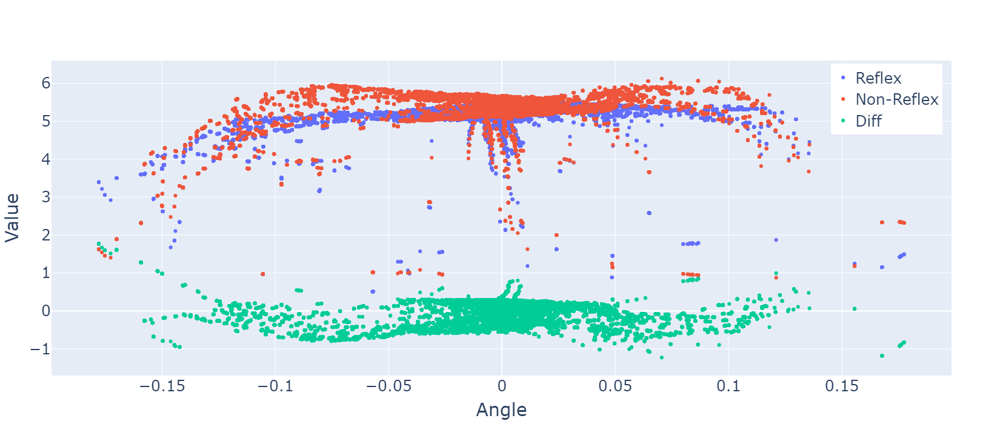

In [69]:
fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(x=df['angle'], y=df['value reflex'],
                    mode='markers',
                    name='Reflex'))
fig.add_trace(go.Scatter(x=df['angle'], y=df['value'],
                    mode='markers',
                    name='Non-Reflex'))

fig.add_trace(go.Scatter(x=df['angle'], y=df['value reflex'] - df['value'],
                    mode='markers',
                    name='Diff'))

fig.update_layout(
#     title='Average evaluation seconds for response times vs max. pertubation during training',
    xaxis_title="Angle",
    yaxis_title="Value",
    xaxis_side='bottom',
    font=dict(size=25),
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    ),
    height=700,
    width=1600
)

fig.show()

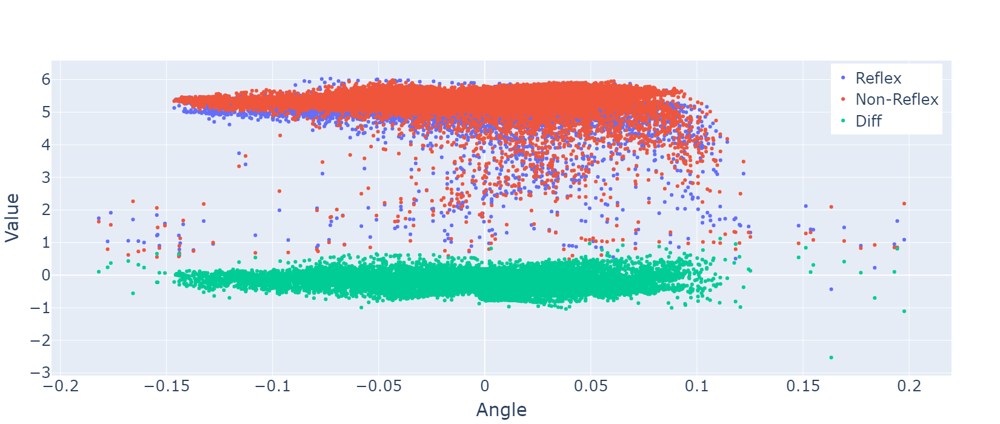

In [70]:
fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(x=df2['angle'], y=df2['value reflex'],
                    mode='markers',
                    name='Reflex'))
fig.add_trace(go.Scatter(x=df2['angle'], y=df2['value'],
                    mode='markers',
                    name='Non-Reflex'))

fig.add_trace(go.Scatter(x=df2['angle'], y=df2['value reflex'] - df2['value'],
                    mode='markers',
                    name='Diff'))

fig.update_layout(
#     title='Average evaluation seconds for response times vs max. pertubation during training',
    xaxis_title="Angle",
    yaxis_title="Value",
    xaxis_side='bottom',
    font=dict(size=25),
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    ),
    height=700,
    width=1600
)

fig.show()